# Look at embeddings for all the data to see consistency across experiments

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA

In [2]:
def get_age(df):
    return df.index.get_level_values('age')

def zscore(df):
    return (df - df.mean()) / df.std()

In [3]:
keep_syllables = np.loadtxt('/n/groups/datta/win/longtogeny/data/ontogeny/version_11/to_keep_syllables_raw.txt', dtype=int)

male_ont = pd.read_parquet('/n/groups/datta/win/longtogeny/data/ontogeny/version_11/ontogeny_males_raw_usage_matrix_v00.parquet')
male_ont = male_ont[keep_syllables]

female_ont = pd.read_parquet('/n/groups/datta/win/longtogeny/data/ontogeny/version_11/ontogeny_females_raw_usage_matrix_v00.parquet')
female_ont = female_ont[keep_syllables]

female_long = pd.read_parquet('/n/groups/datta/win/longtogeny/data/ontogeny/version_11/longtogeny_v2_females_raw_usage_matrix_v00.parquet')
female_long = female_long[keep_syllables]

male_long = pd.read_parquet('/n/groups/datta/win/longtogeny/data/ontogeny/version_11/longtogeny_v2_males_raw_usage_matrix_v00.parquet')
male_long = male_long[keep_syllables]

Text(0.5, 1.0, 'Male ontogeny')

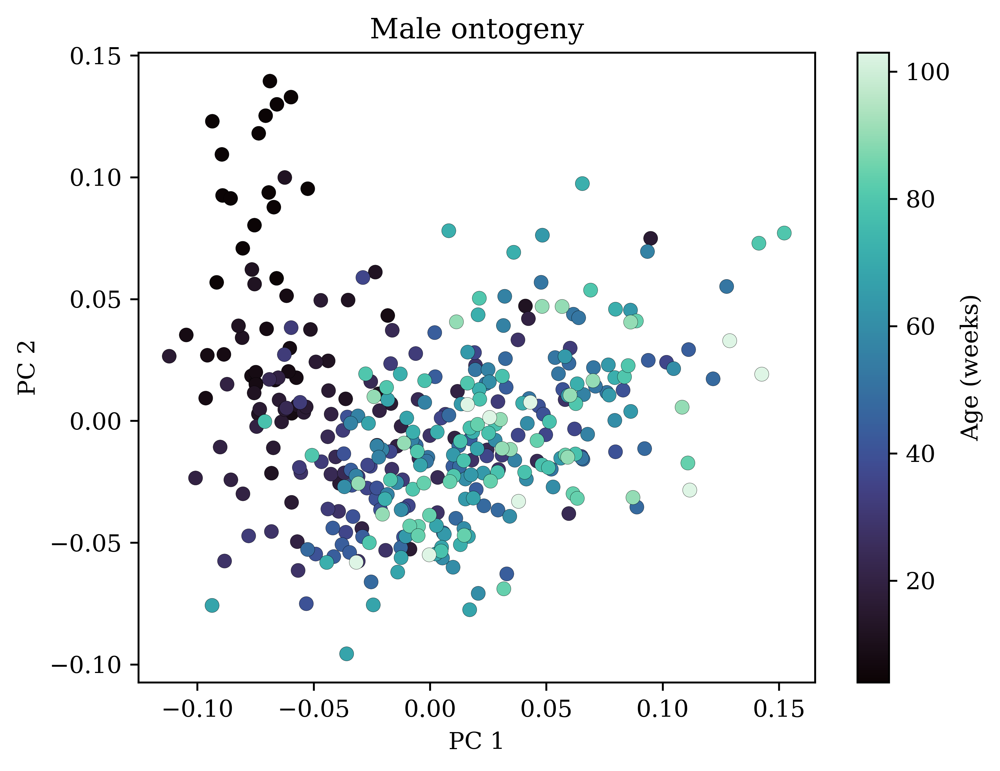

In [4]:
scores = PCA(n_components=2).fit_transform(male_ont)

plt.scatter(scores[:, 0], scores[:, 1], c=get_age(male_ont), cmap='mako', linewidths=0.1, edgecolors='k')
plt.colorbar(label="Age (weeks)")
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.title("Male ontogeny")

Text(0.5, 1.0, 'Female ontogeny')

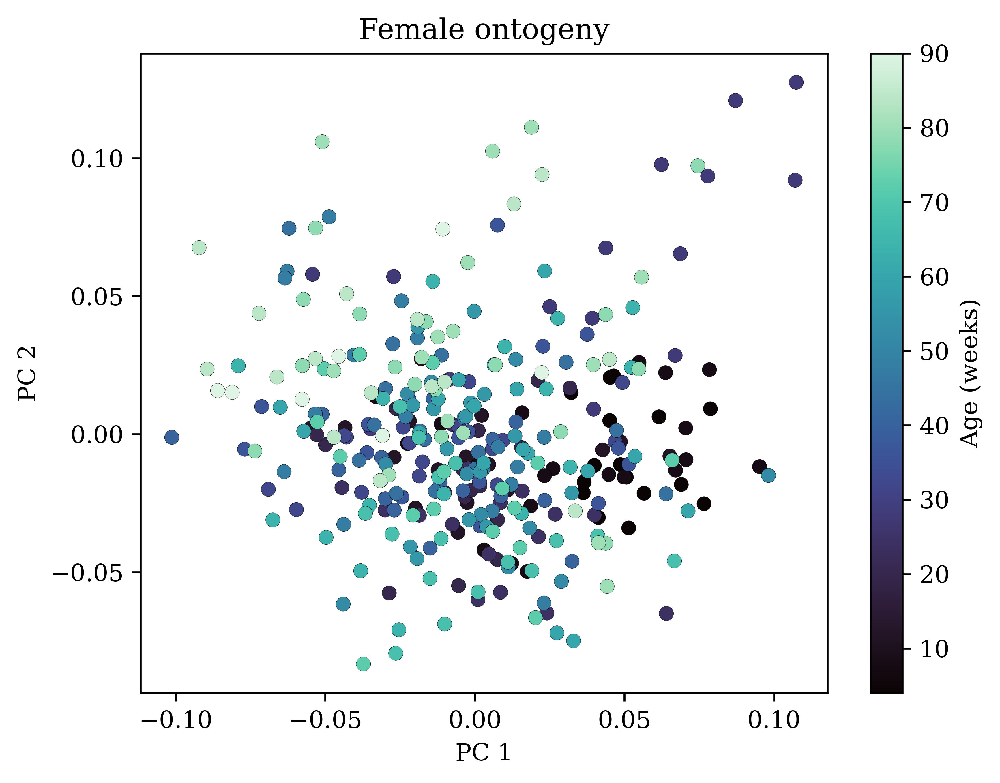

In [5]:
scores = PCA(n_components=2).fit_transform(female_ont.query('age < 100'))

plt.scatter(scores[:, 0], scores[:, 1], c=get_age(female_ont.query('age < 100')), cmap='mako', linewidths=0.1, edgecolors='k')
plt.colorbar(label="Age (weeks)")
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.title("Female ontogeny")

Text(0.5, 1.0, 'Combined male and female ontogeny')

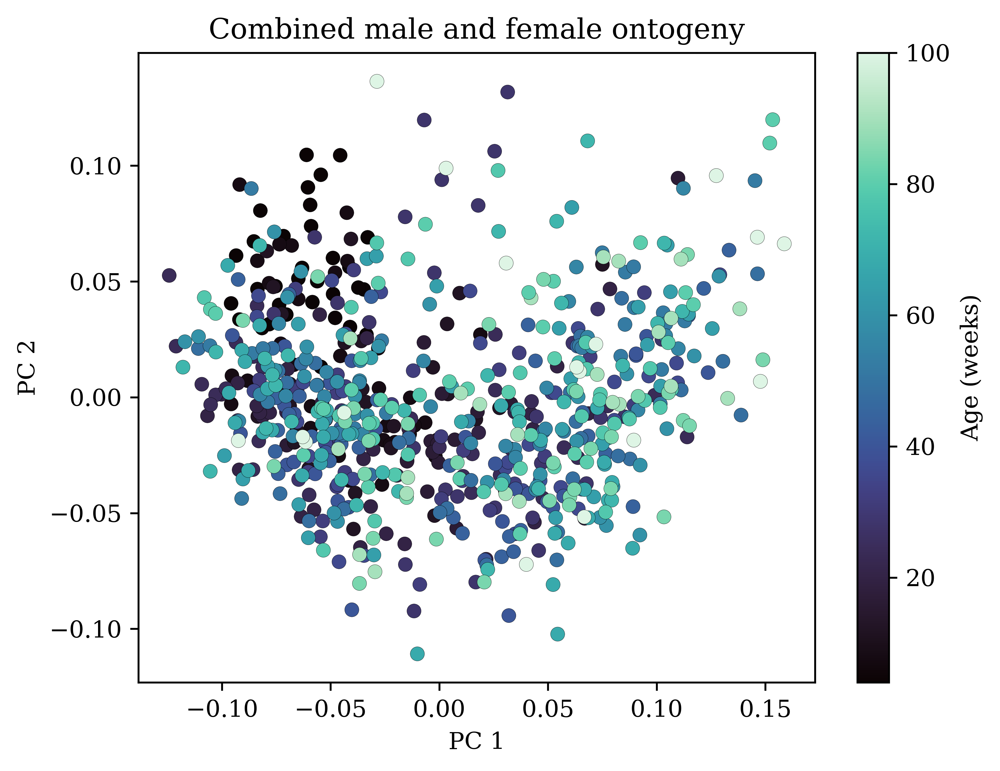

In [6]:
scores = PCA(n_components=2).fit_transform(pd.concat([male_ont, female_ont]))
plt.scatter(scores[:, 0], scores[:, 1], c=get_age(pd.concat([male_ont, female_ont])), cmap='mako', linewidths=0.1, edgecolors='k', vmax=100)
plt.colorbar(label="Age (weeks)")
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.title("Combined male and female ontogeny")

Text(0.5, 1.0, 'Combined male and female ontogeny')

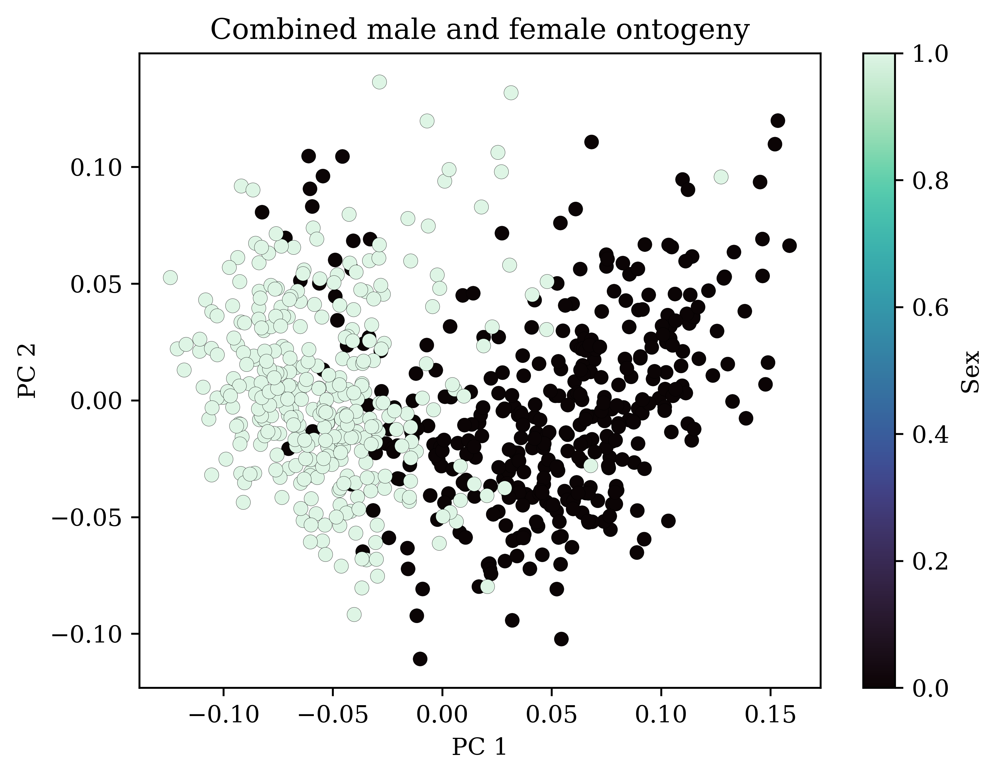

In [7]:
scores = PCA(n_components=2).fit_transform(pd.concat([male_ont, female_ont]))
plt.scatter(scores[:, 0], scores[:, 1], c=[0] * len(male_ont) + [1] * len(female_ont), cmap='mako', linewidths=0.1, edgecolors='k')
plt.colorbar(label="Sex")
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.title("Combined male and female ontogeny")

Text(0.5, 1.0, 'Male longtogeny')

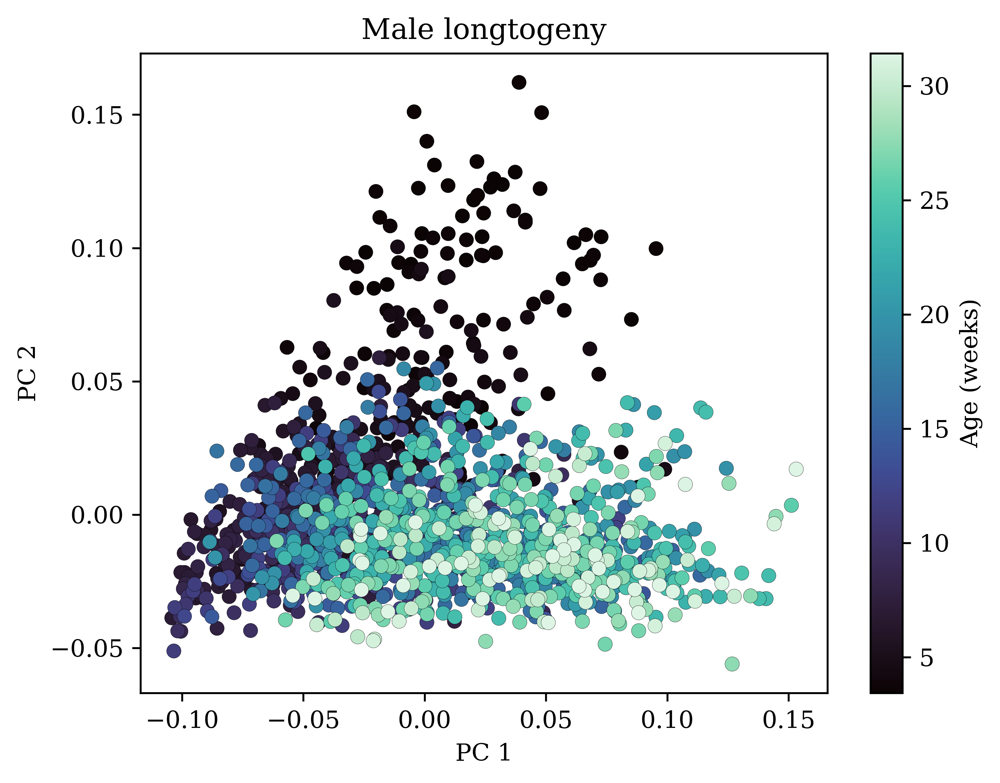

In [8]:
scores = PCA(n_components=2).fit_transform(male_long)

plt.scatter(scores[:, 0], scores[:, 1], c=get_age(male_long), cmap='mako', linewidths=0.1, edgecolors='k')
plt.colorbar(label="Age (weeks)")
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.title("Male longtogeny")

Text(0.5, 1.0, 'Female longtogeny')

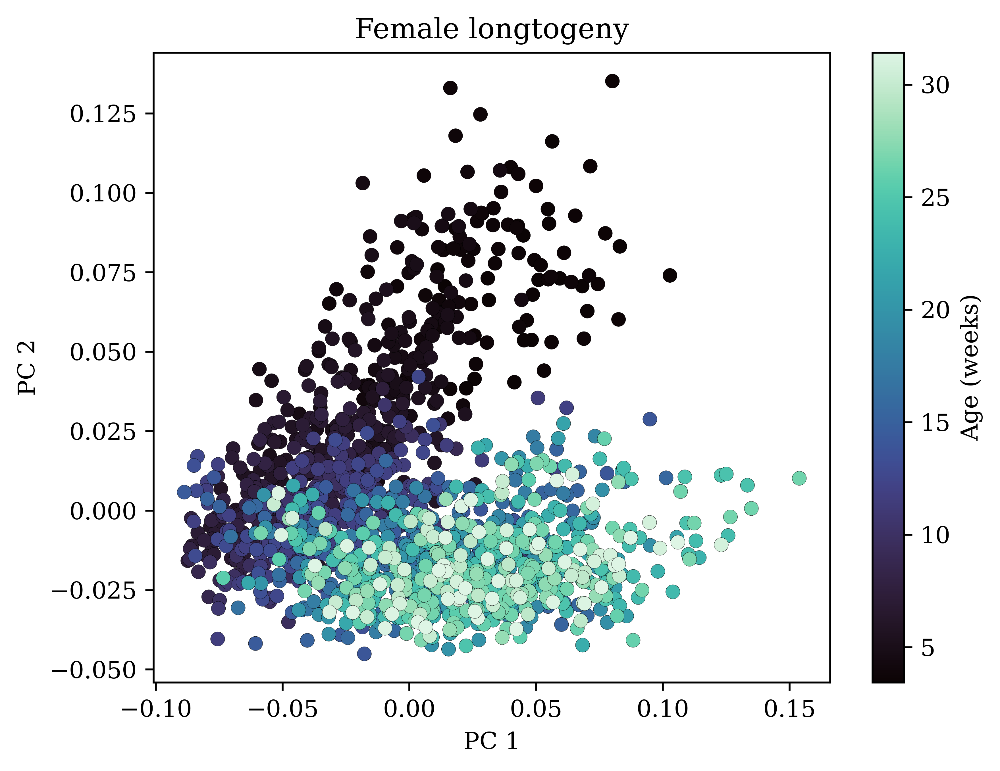

In [9]:
scores = PCA(n_components=2).fit_transform(female_long)

plt.scatter(scores[:, 0], scores[:, 1], c=get_age(female_long), cmap='mako', linewidths=0.1, edgecolors='k')
plt.colorbar(label="Age (weeks)")
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.title("Female longtogeny")

Text(0.5, 1.0, 'Combined male and female longtogeny')

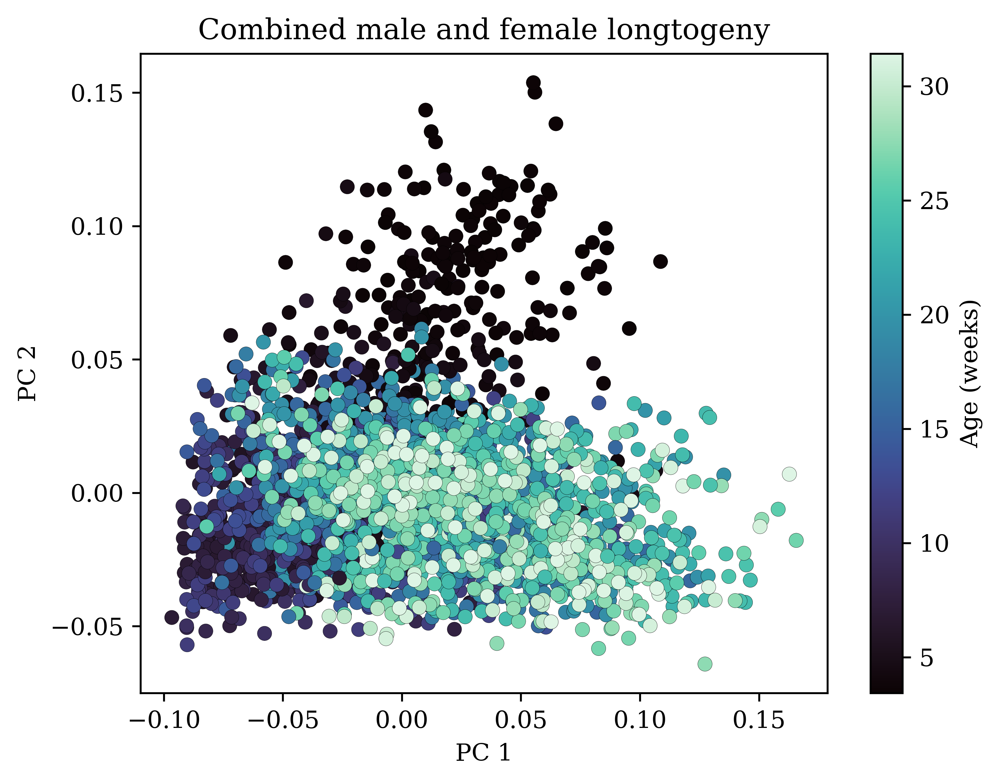

In [10]:
scores = PCA(n_components=2).fit_transform(pd.concat([male_long, female_long]))
# plt.scatter(scores[:, 0], scores[:, 1], c=[0] * len(male_long) + [1] * len(female_long), cmap='mako', linewidths=0.1, edgecolors='k')
plt.scatter(scores[:, 0], scores[:, 1], c=get_age(pd.concat([male_long, female_long])), cmap='mako', linewidths=0.1, edgecolors='k')
plt.colorbar(label="Age (weeks)")
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.title("Combined male and female longtogeny")

Text(0.5, 1.0, 'Combined male and female longtogeny')

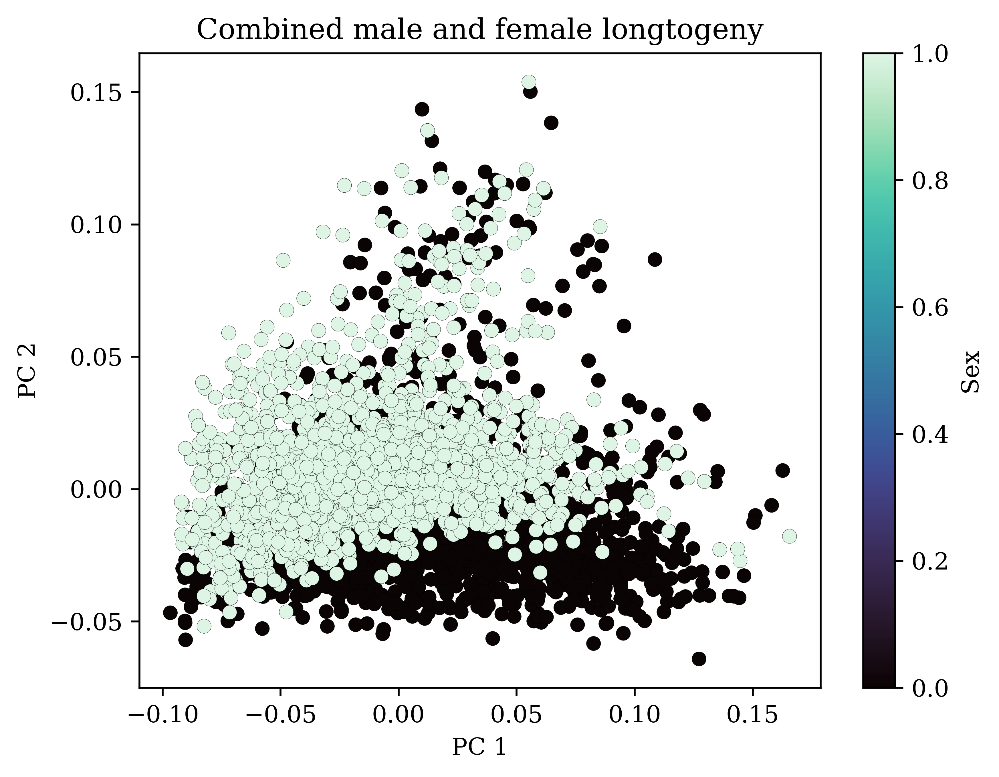

In [11]:
scores = PCA(n_components=2).fit_transform(pd.concat([male_long, female_long]))
plt.scatter(scores[:, 0], scores[:, 1], c=[0] * len(male_long) + [1] * len(female_long), cmap='mako', linewidths=0.1, edgecolors='k')
# plt.scatter(scores[:, 0], scores[:, 1], c=get_age(pd.concat([male_long, female_long])), cmap='mako', linewidths=0.1, edgecolors='k')
plt.colorbar(label="Sex")
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.title("Combined male and female longtogeny")

## Plot usage 

In [12]:
sorting = np.loadtxt("/n/groups/datta/win/longtogeny/data/ontogeny/version_11/syllable_sort_by_peak.txt", dtype=int)

Text(0.5, 1.0, 'Female longtogeny')

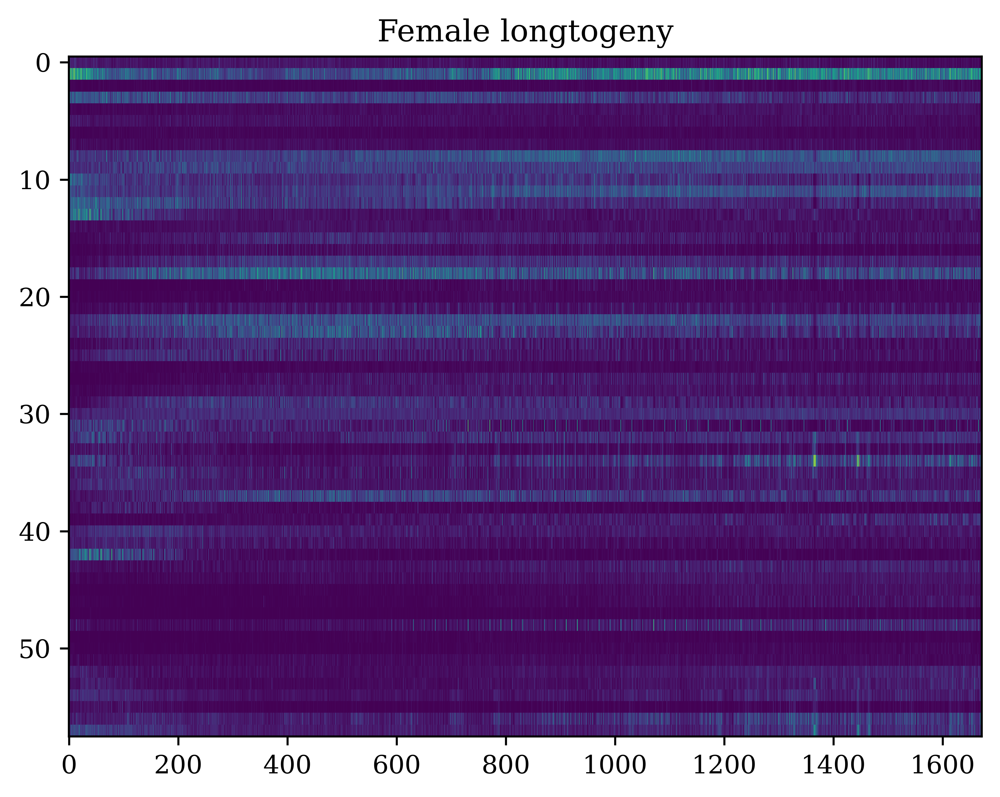

In [14]:
plt.imshow(female_long[sorting].T, aspect='auto', interpolation='none')
plt.title("Female longtogeny")

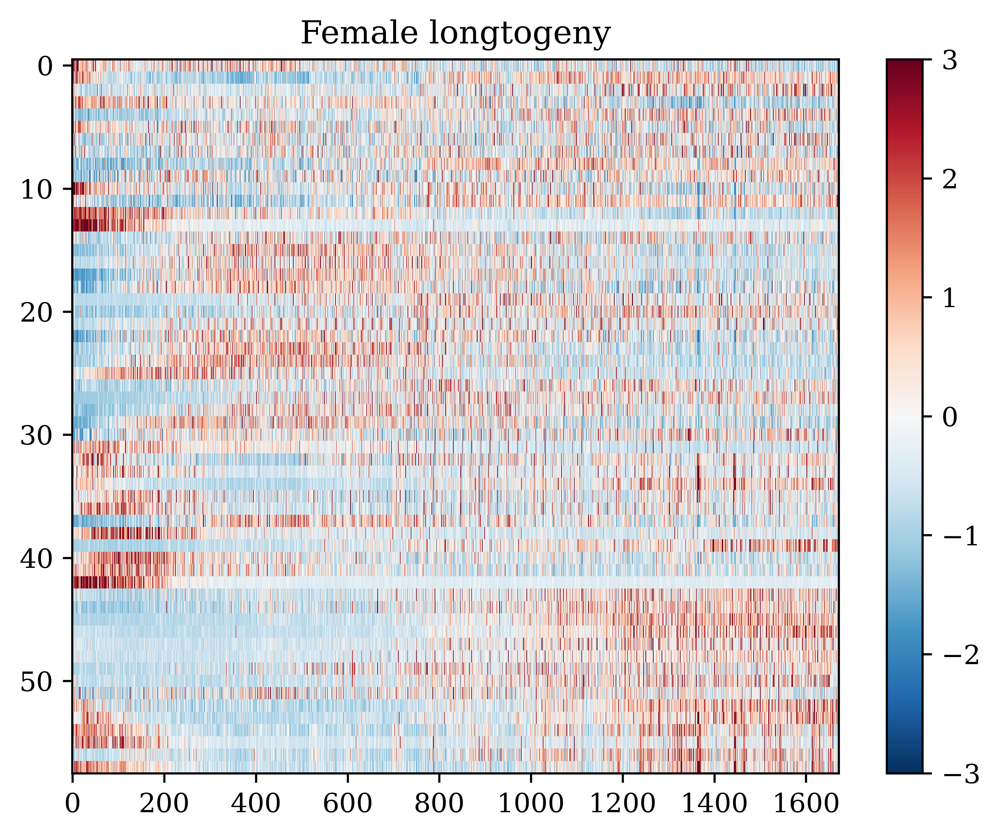

In [15]:
plt.imshow(zscore(female_long[sorting]).T, aspect='auto', interpolation='none', cmap='RdBu_r', vmax=3, vmin=-3)
plt.title("Female longtogeny")
plt.colorbar()

Text(0.5, 1.0, 'Male longtogeny')

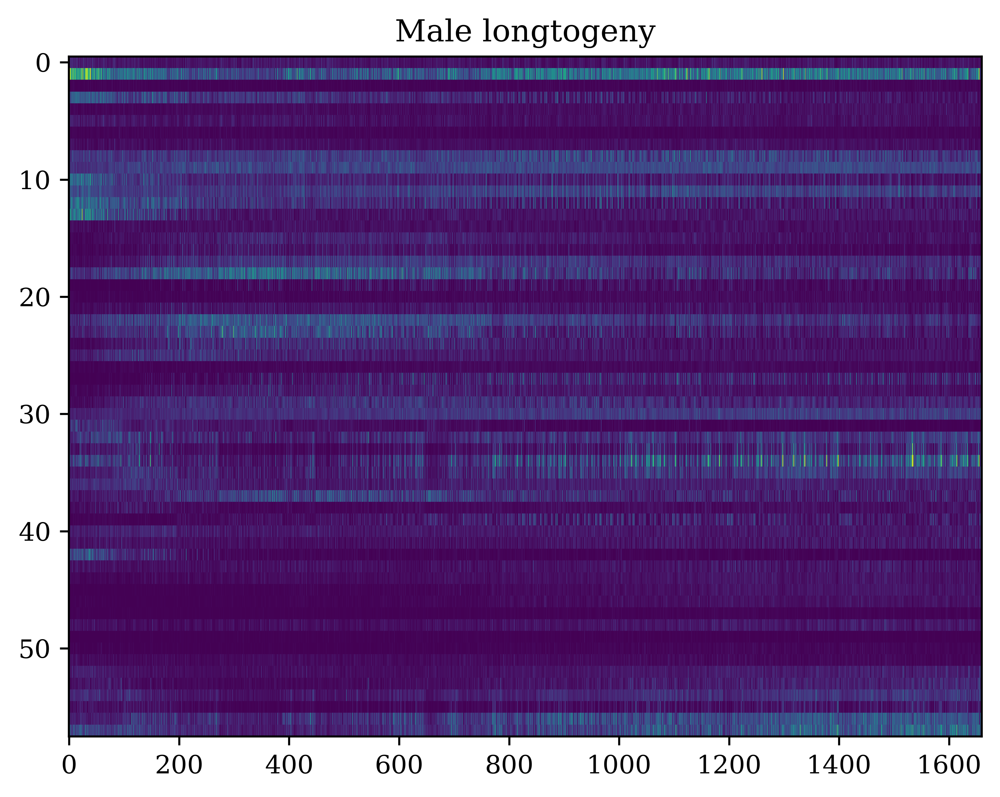

In [16]:
plt.imshow(male_long[sorting].T, aspect='auto', interpolation='none')
plt.title("Male longtogeny")

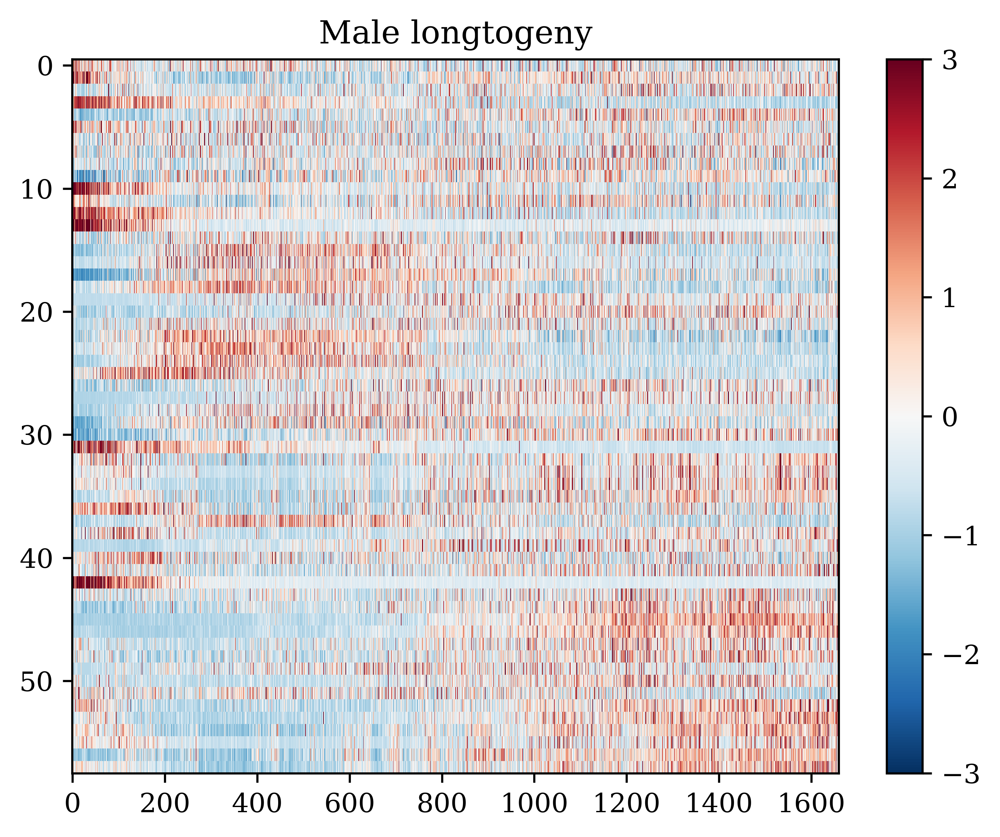

In [17]:
plt.imshow(zscore(male_long[sorting]).T, aspect='auto', interpolation='none', cmap='RdBu_r', vmax=3, vmin=-3)
plt.title("Male longtogeny")
plt.colorbar()

Text(0.5, 1.0, 'Female ontogeny')

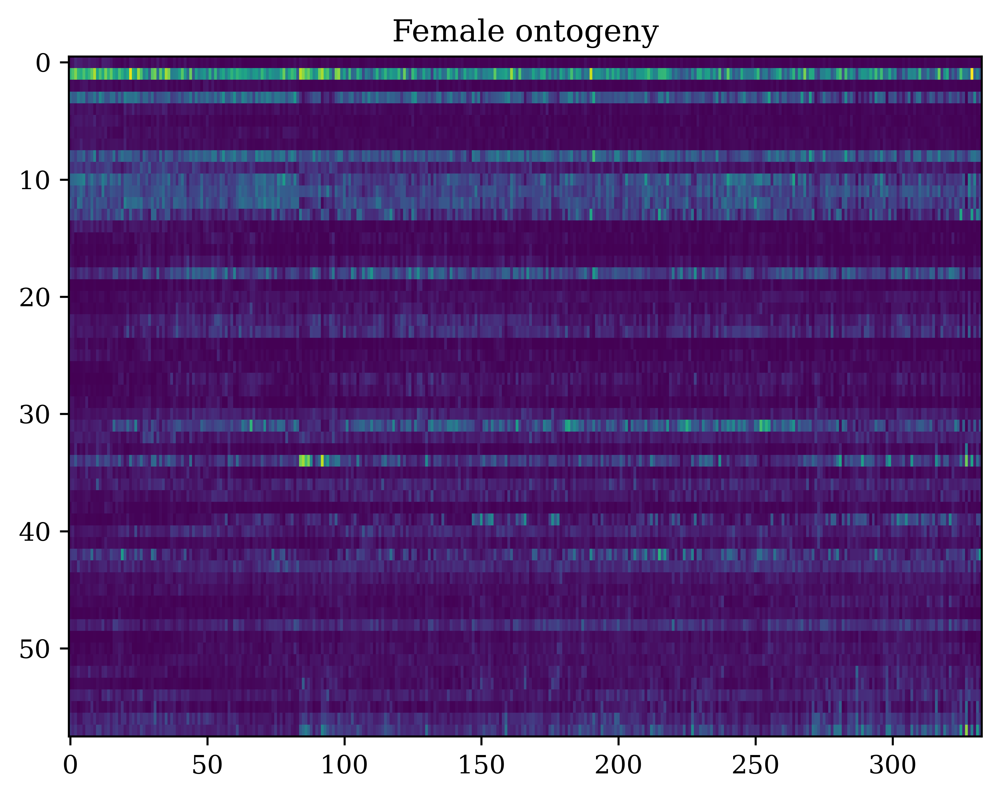

In [18]:
plt.imshow(female_ont[sorting].astype(float).T, aspect='auto', interpolation='none')
plt.title("Female ontogeny")

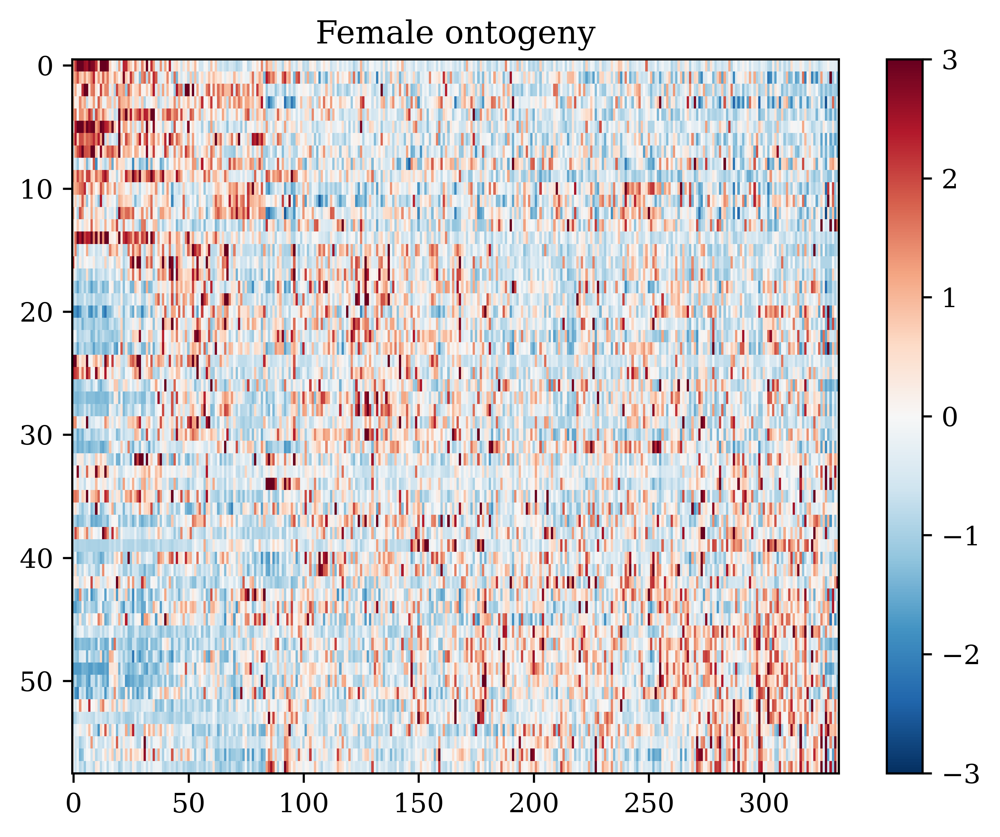

In [19]:
plt.imshow(zscore(female_ont[sorting].astype(float)).T, aspect='auto', interpolation='none', cmap='RdBu_r', vmax=3, vmin=-3)
plt.title("Female ontogeny")
plt.colorbar()

In [22]:
from sklearn.decomposition import PCA

In [23]:
scores = PCA(n_components=2).fit_transform(zscore(female_ont))

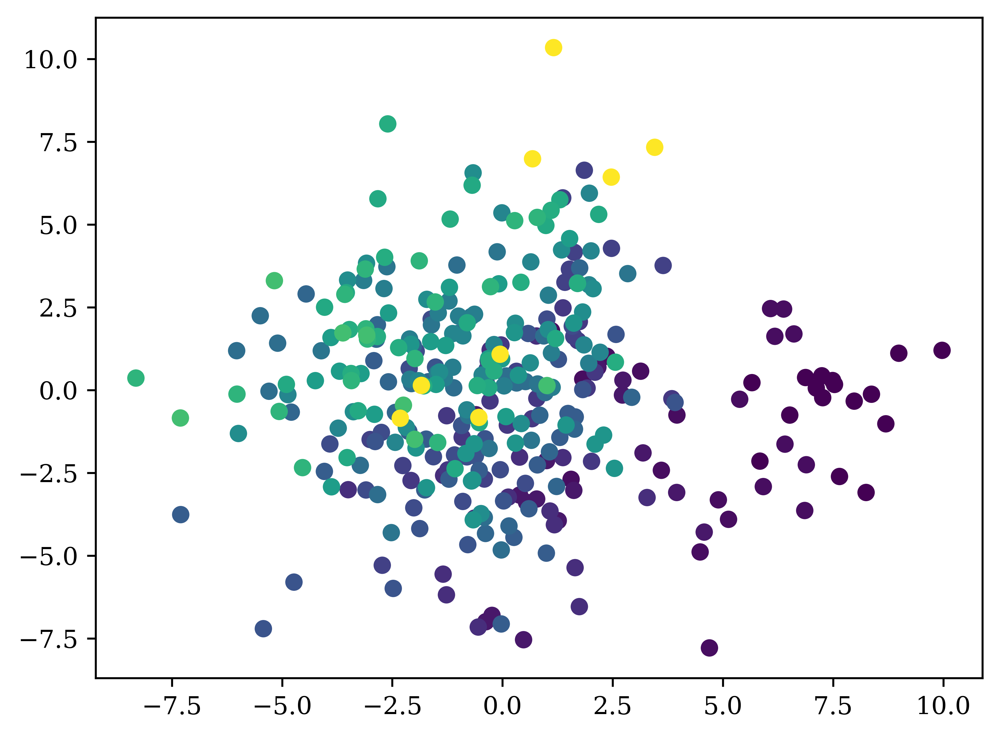

In [25]:
plt.scatter(scores[:, 0], scores[:, 1], c=female_ont.index.get_level_values('age'))

Text(0.5, 1.0, 'Male ontogeny')

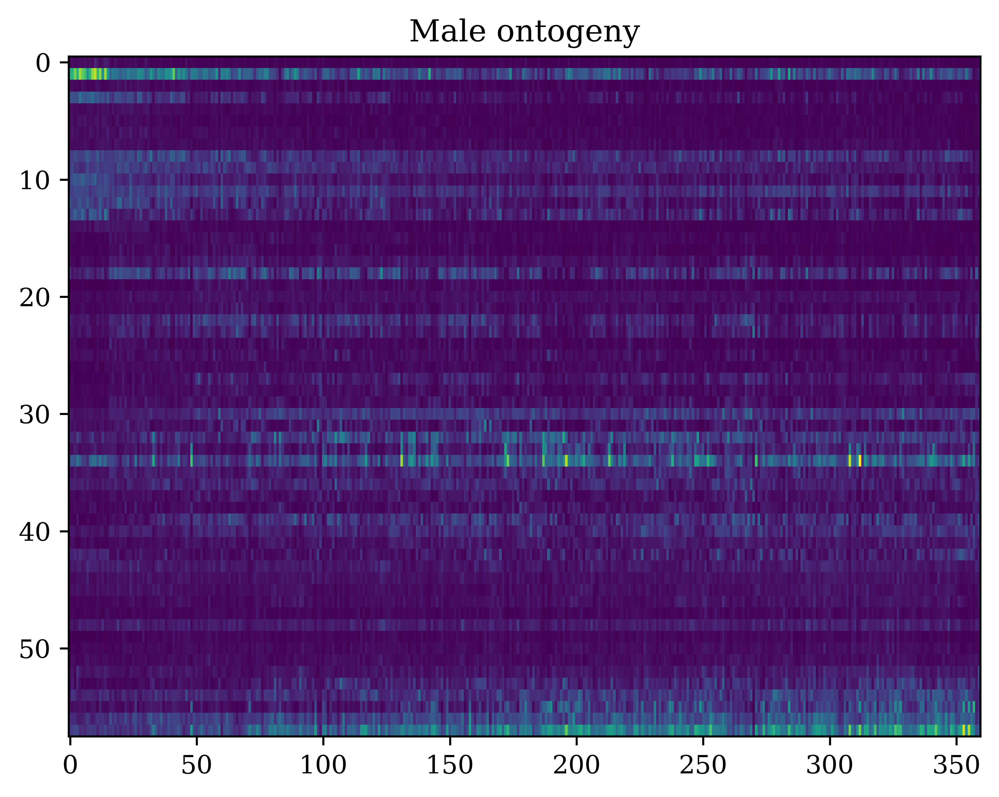

In [20]:
plt.imshow(male_ont[sorting].astype(float).T, aspect='auto', interpolation='none')
plt.title("Male ontogeny")

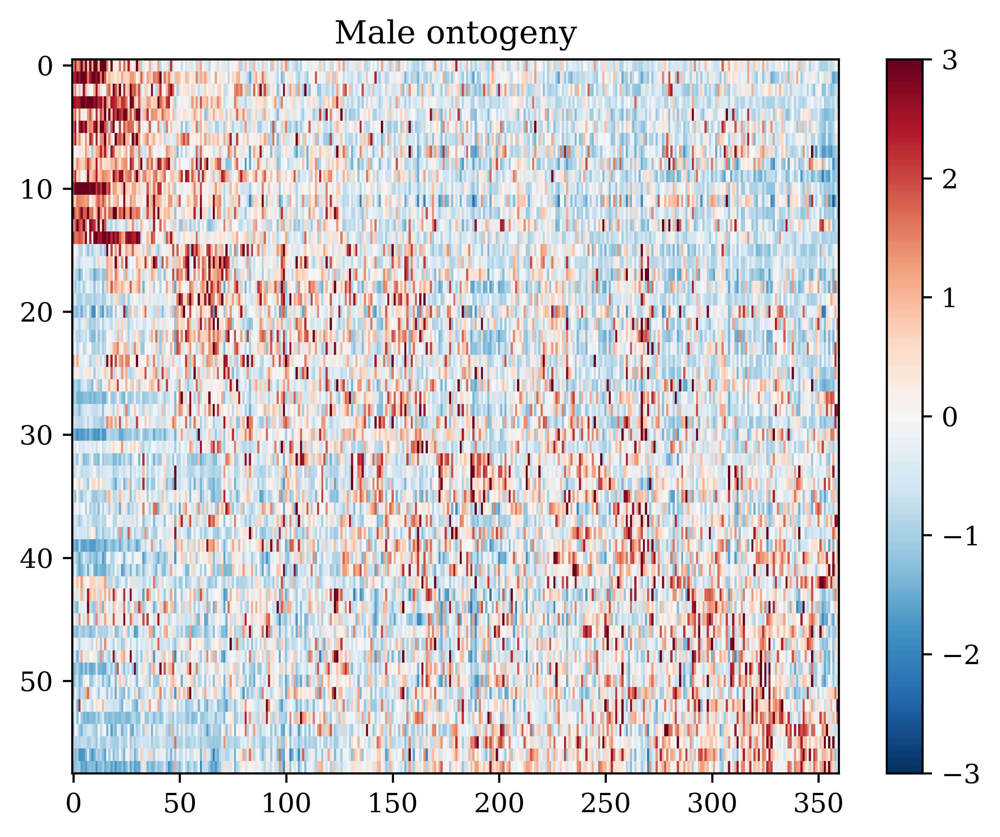

In [21]:
plt.imshow(zscore(male_ont[sorting].astype(float)).T, aspect='auto', interpolation='none', cmap='RdBu_r', vmax=3, vmin=-3)
plt.title("Male ontogeny")
plt.colorbar()

<Axes: xlabel='syllables'>

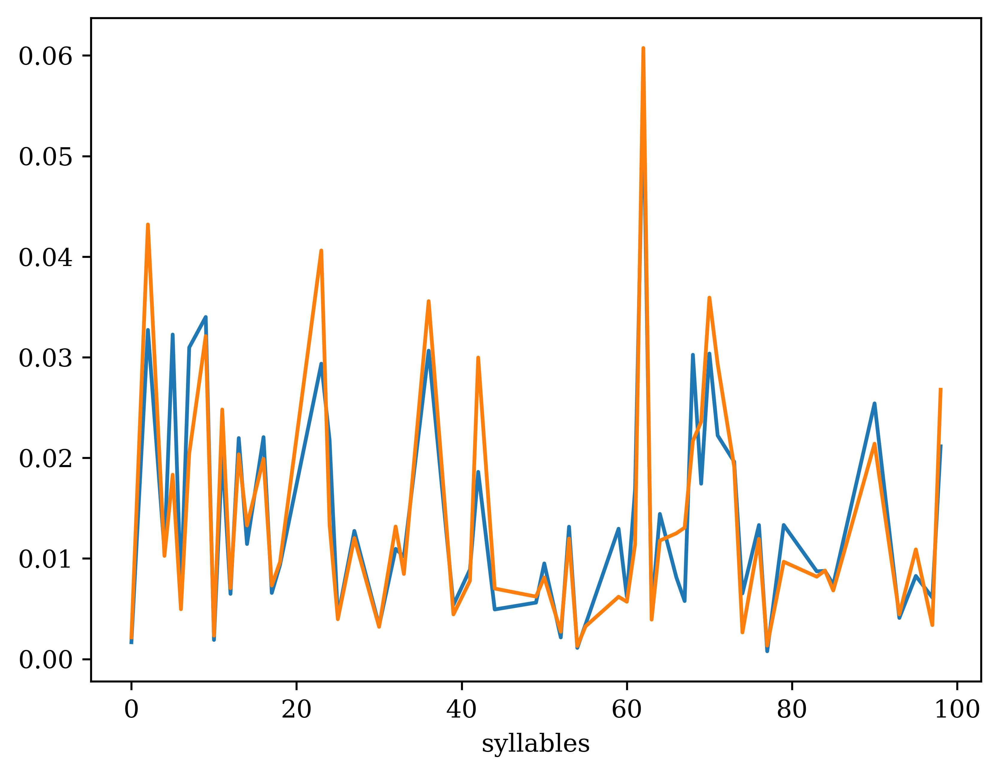

In [14]:
male_long.mean().plot()
female_long.mean().plot()

<Axes: xlabel='syllables'>

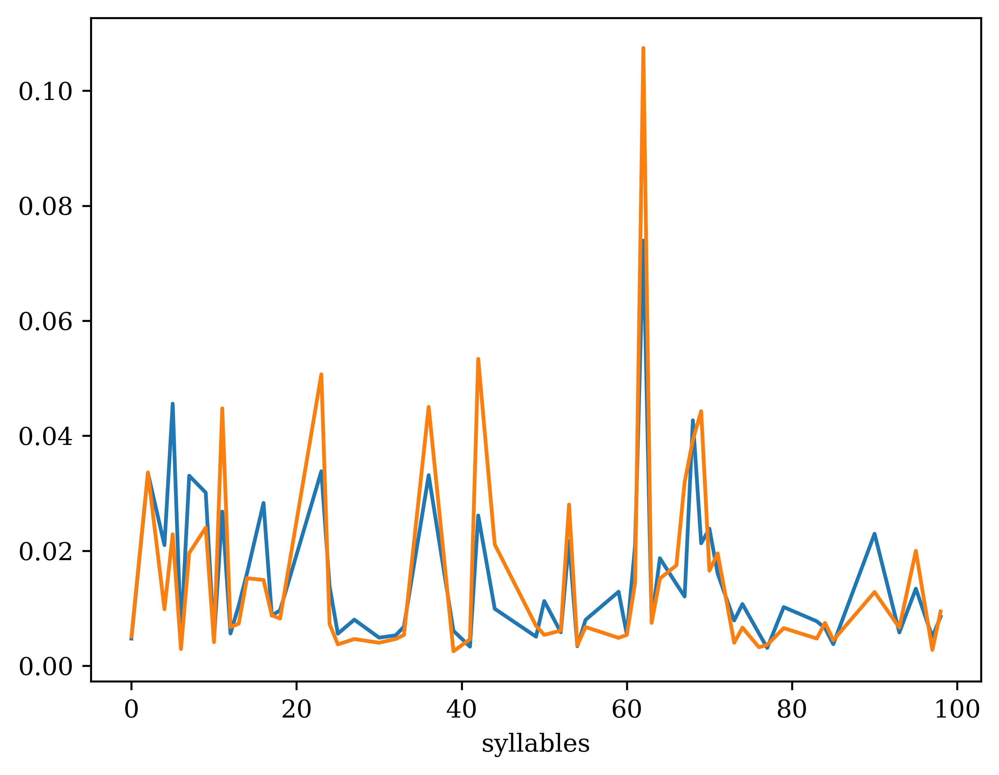

In [15]:
male_ont.loc[:30].mean().plot()
female_ont.loc[:30].mean().plot()

Text(0.5, 1.0, 'Combined male and female ontogeny')

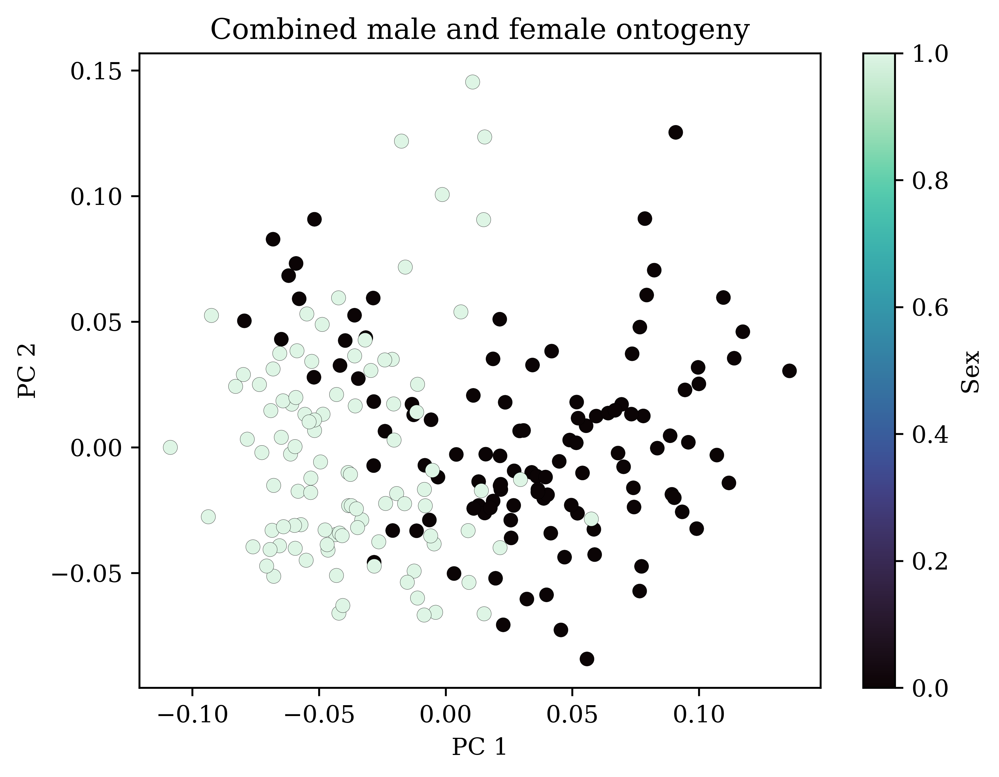

In [16]:
scores = PCA(n_components=2).fit_transform(pd.concat([male_ont.loc[:30], female_ont.loc[:30]]))
plt.scatter(scores[:, 0], scores[:, 1], c=[0] * len(male_ont.loc[:30]) + [1] * len(female_ont.loc[:30]), cmap='mako', linewidths=0.1, edgecolors='k')
plt.colorbar(label="Sex")
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.title("Combined male and female ontogeny")

Text(0.5, 1.0, 'Combined male and female ontogeny')

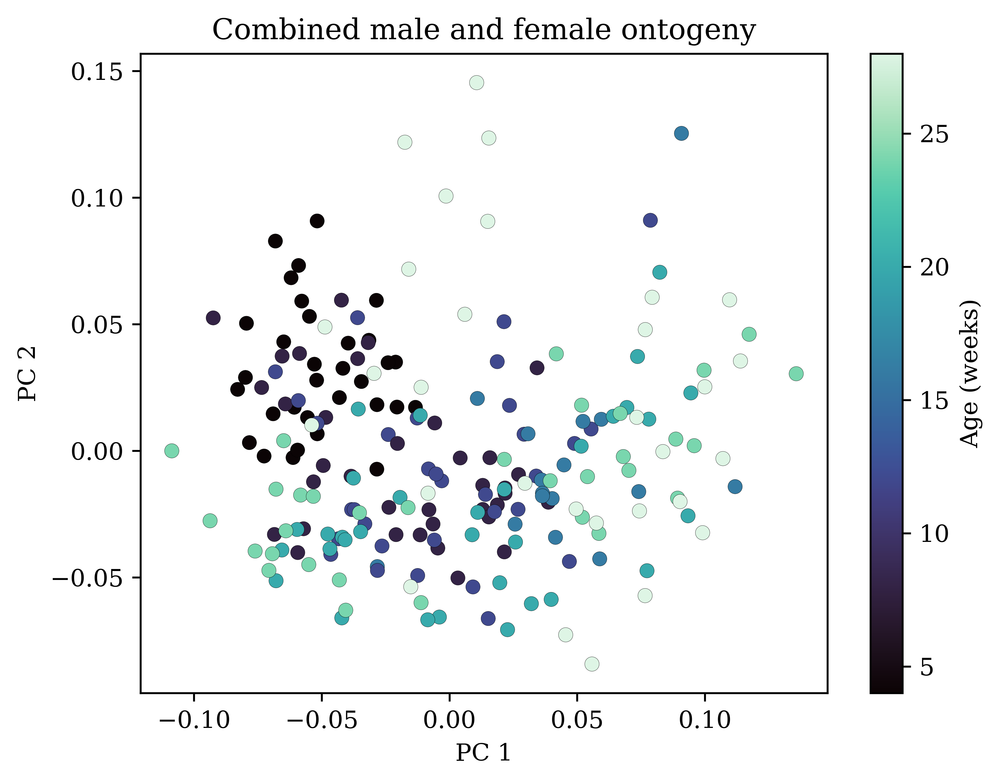

In [20]:
scores = PCA(n_components=2).fit_transform(pd.concat([male_ont.loc[:30], female_ont.loc[:30]]))
plt.scatter(scores[:, 0], scores[:, 1], c=get_age(pd.concat([male_ont.loc[:30], female_ont.loc[:30]])), cmap='mako', linewidths=0.1, edgecolors='k')
plt.colorbar(label="Age (weeks)")
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.title("Combined male and female ontogeny")

## Z-score and then co-embed

Text(0.5, 1.0, 'Combined male and female ontogeny')

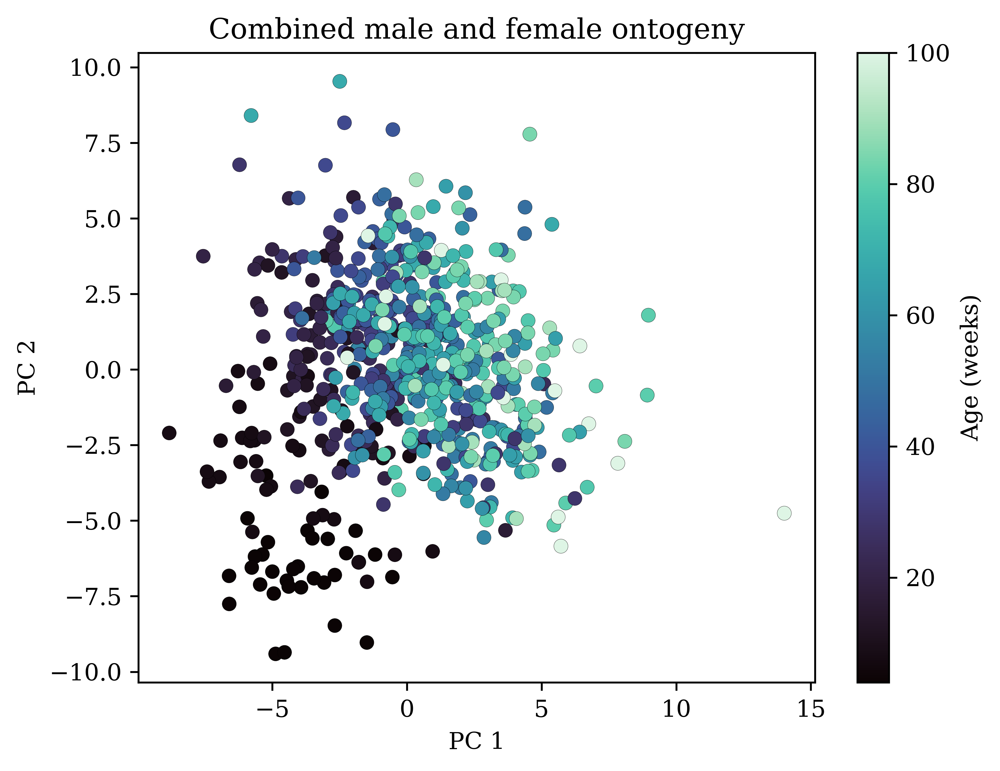

In [26]:
scores = PCA(n_components=2).fit_transform(pd.concat([zscore(male_ont), zscore(female_ont)]))
plt.scatter(scores[:, 0], scores[:, 1], c=get_age(pd.concat([male_ont, female_ont])), cmap='mako', linewidths=0.1, edgecolors='k', vmax=100)
plt.colorbar(label="Age (weeks)")
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.title("Combined male and female ontogeny")

Text(0.5, 1.0, 'Combined male and female ontogeny')

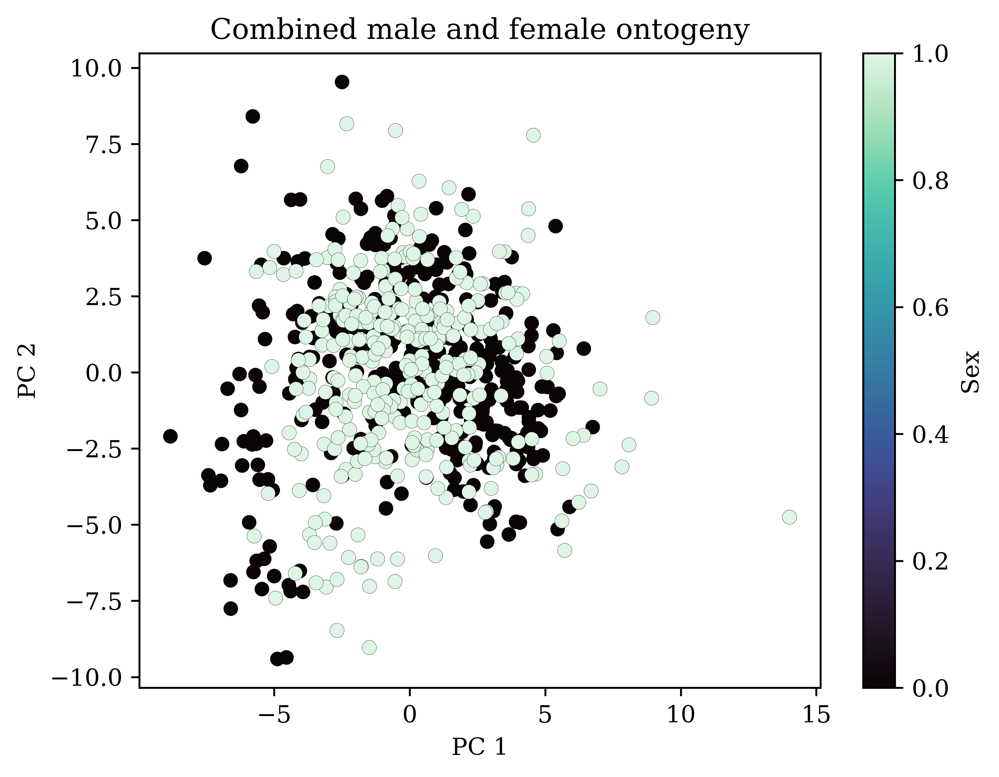

In [29]:
scores = PCA(n_components=2).fit_transform(pd.concat([zscore(male_ont), zscore(female_ont)]))
plt.scatter(scores[:, 0], scores[:, 1], c=[0] * len(male_ont) + [1] * len(female_ont), cmap='mako', linewidths=0.1, edgecolors='k')
plt.colorbar(label="Sex")
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.title("Combined male and female ontogeny")

In [33]:
set(female_ont.index.get_level_values('uuid')).intersection(set(male_ont.index.get_level_values('uuid')))

set()

Text(0.5, 1.0, 'Combined male and female longtogeny')

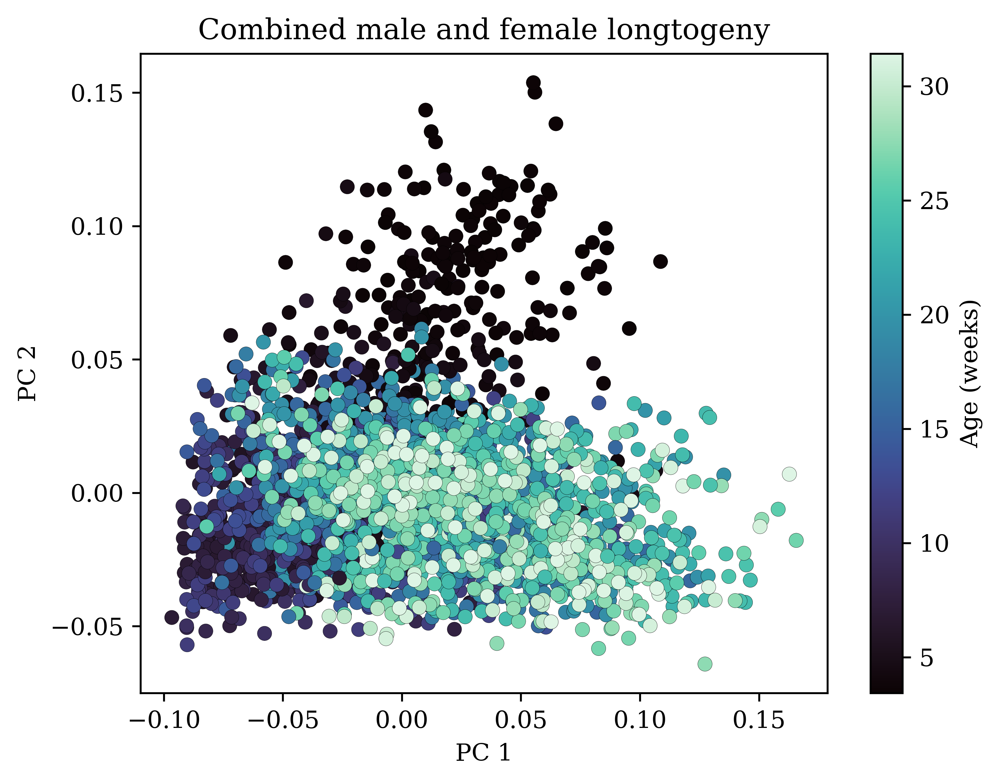

In [10]:
scores = PCA(n_components=2).fit_transform(pd.concat([male_long, female_long]))
# plt.scatter(scores[:, 0], scores[:, 1], c=[0] * len(male_long) + [1] * len(female_long), cmap='mako', linewidths=0.1, edgecolors='k')
plt.scatter(scores[:, 0], scores[:, 1], c=get_age(pd.concat([male_long, female_long])), cmap='mako', linewidths=0.1, edgecolors='k')
plt.colorbar(label="Age (weeks)")
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.title("Combined male and female longtogeny")

Text(0.5, 1.0, 'Combined male and female longtogeny')

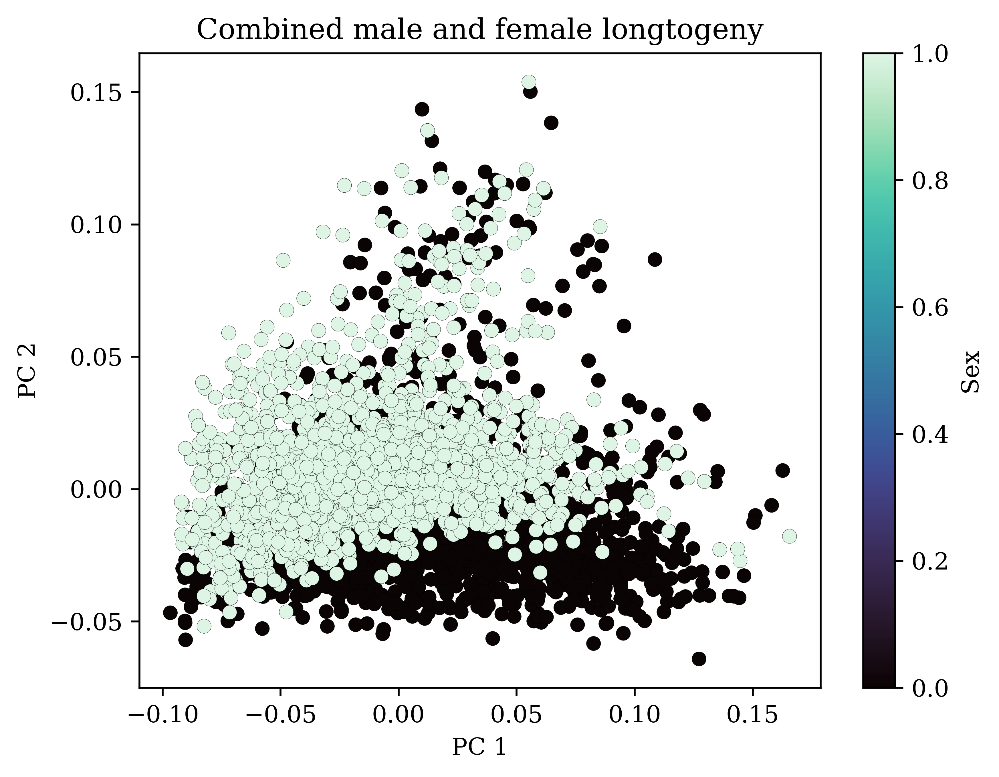

In [11]:
scores = PCA(n_components=2).fit_transform(pd.concat([male_long, female_long]))
plt.scatter(scores[:, 0], scores[:, 1], c=[0] * len(male_long) + [1] * len(female_long), cmap='mako', linewidths=0.1, edgecolors='k')
# plt.scatter(scores[:, 0], scores[:, 1], c=get_age(pd.concat([male_long, female_long])), cmap='mako', linewidths=0.1, edgecolors='k')
plt.colorbar(label="Sex")
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.title("Combined male and female longtogeny")